# Regressão logística

## Teoria

### O que é?

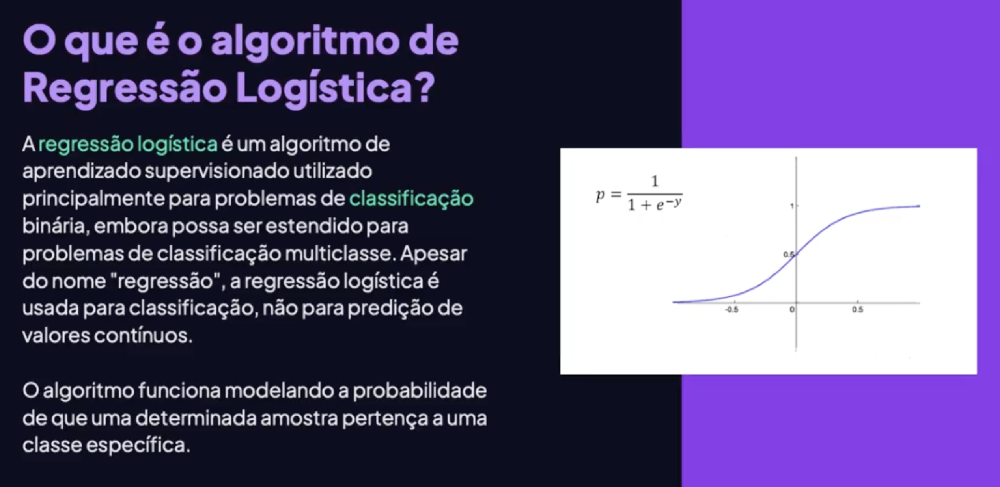

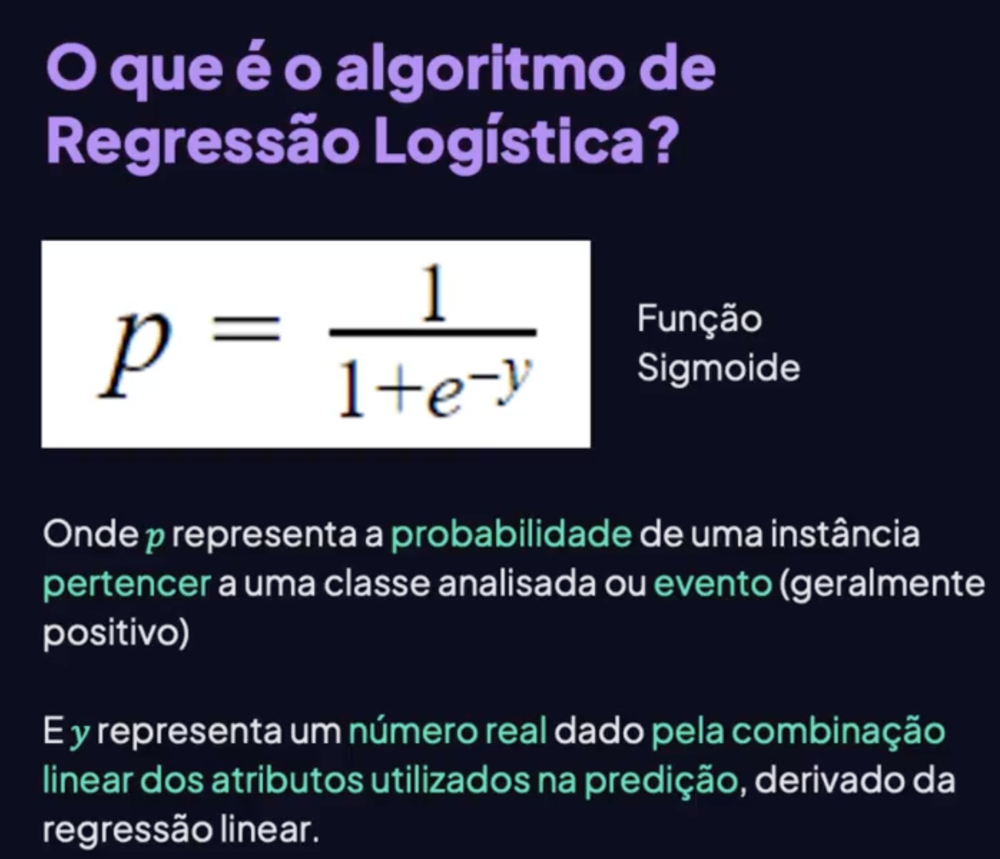

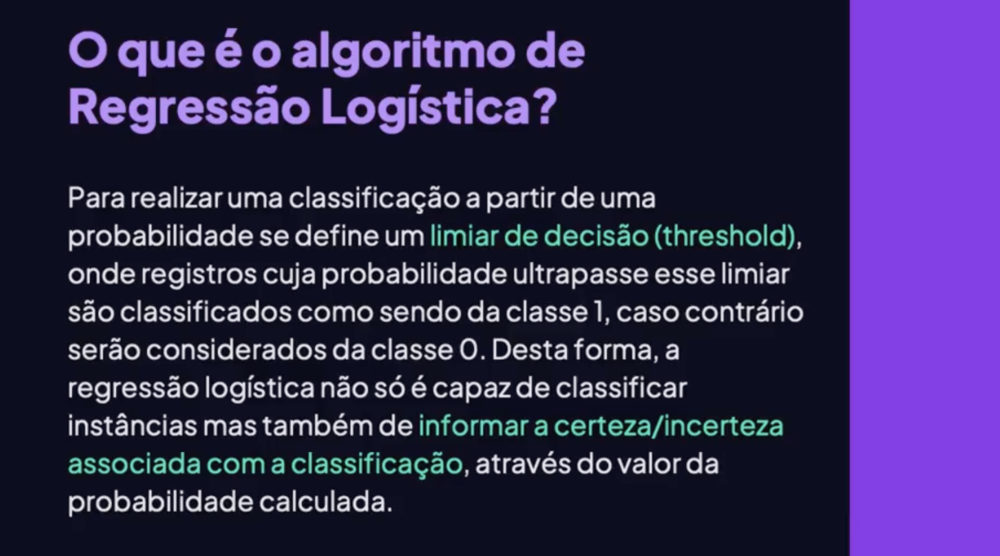

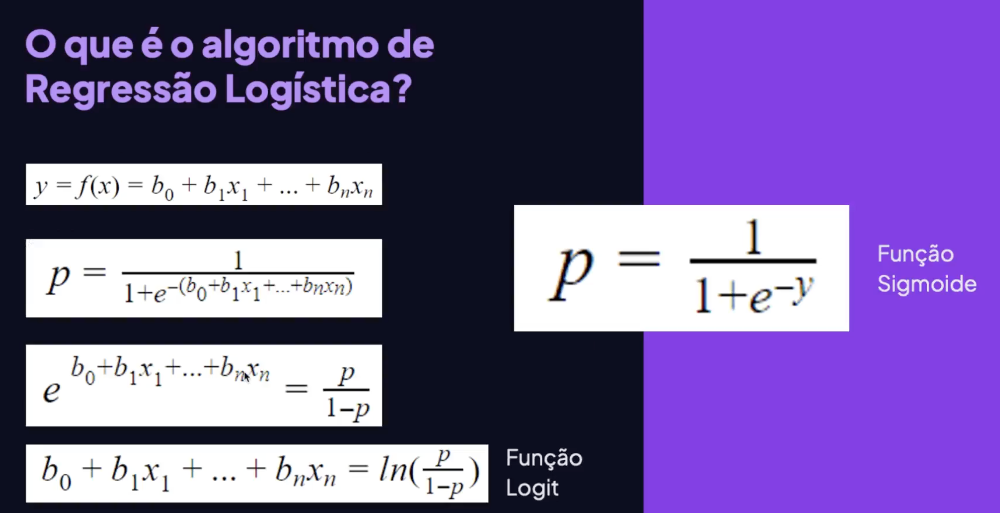

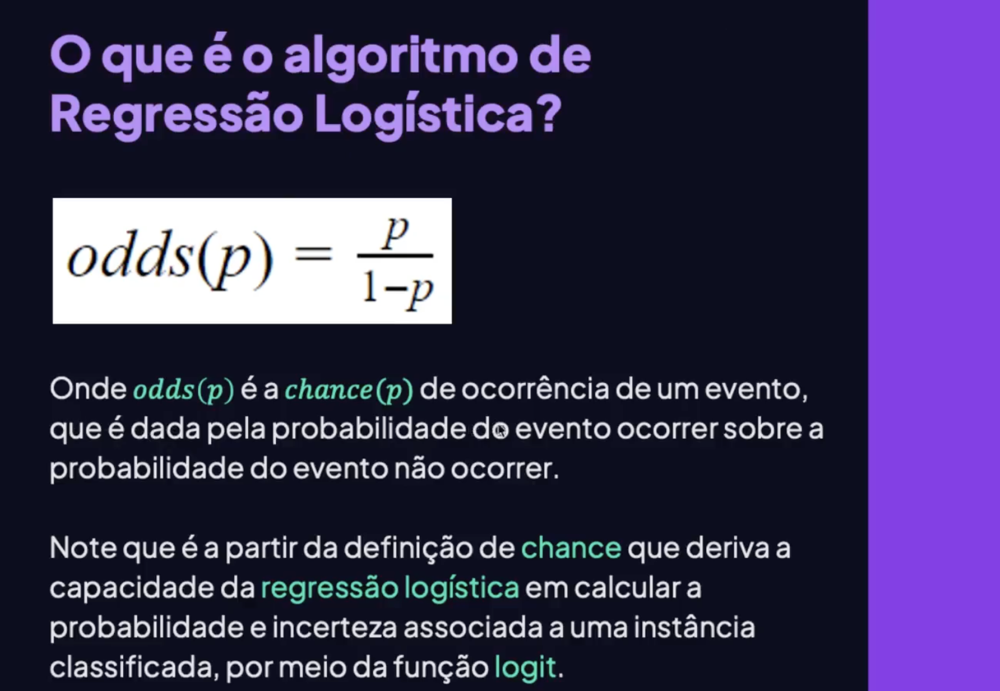

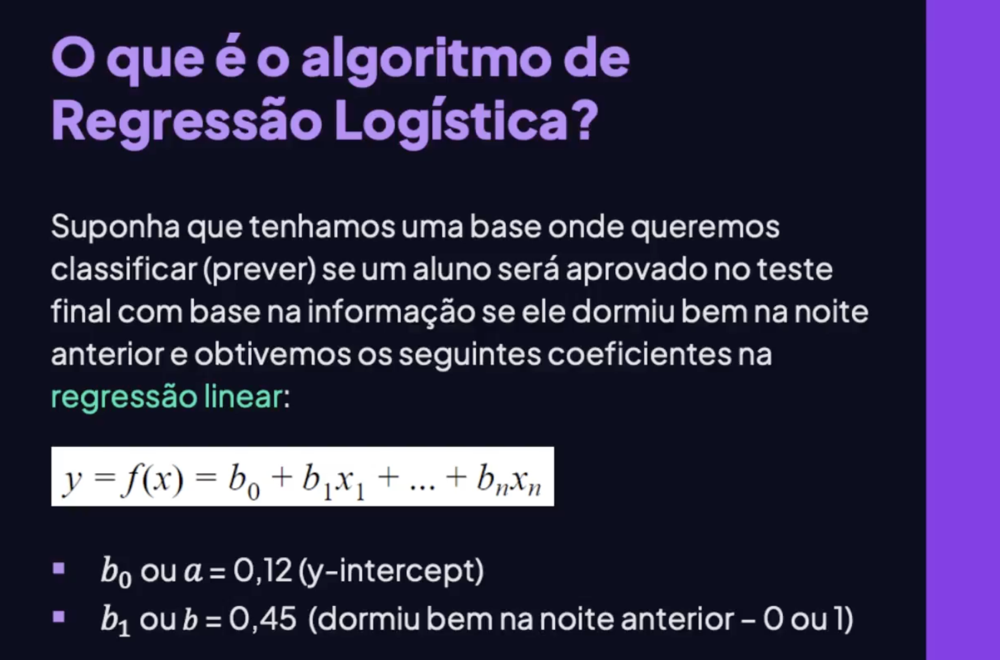

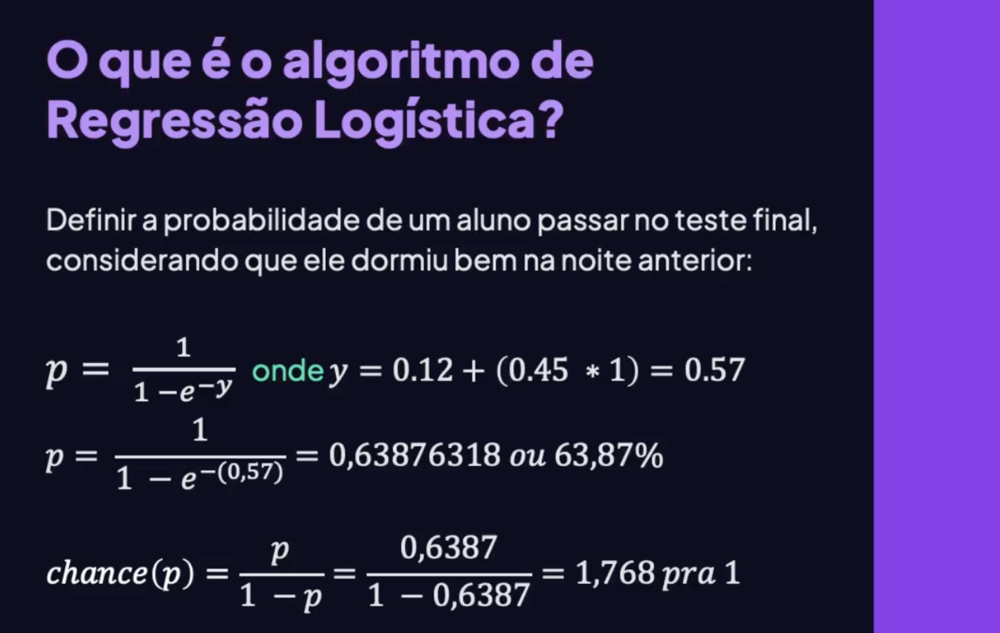

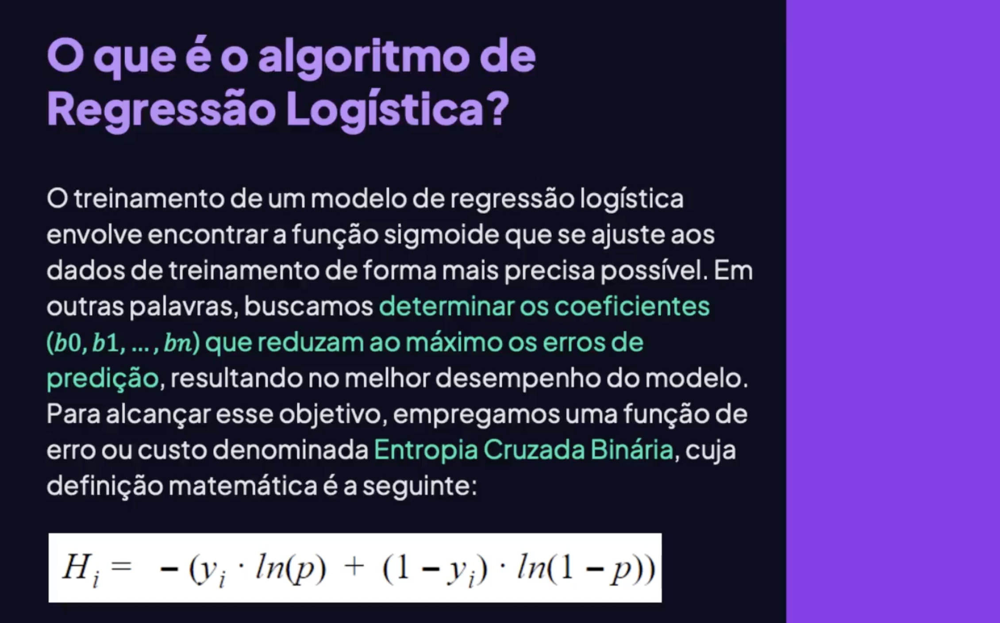

### Métricas de classificação

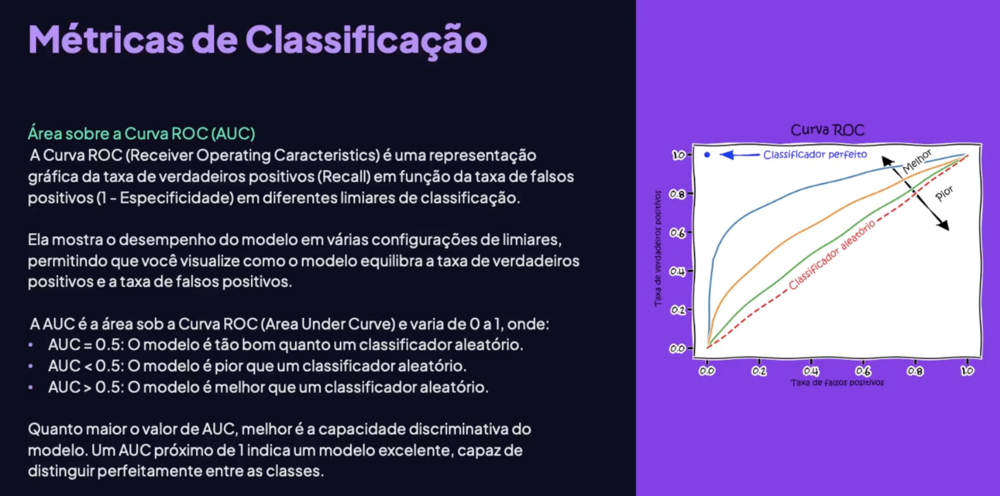

### Projeto

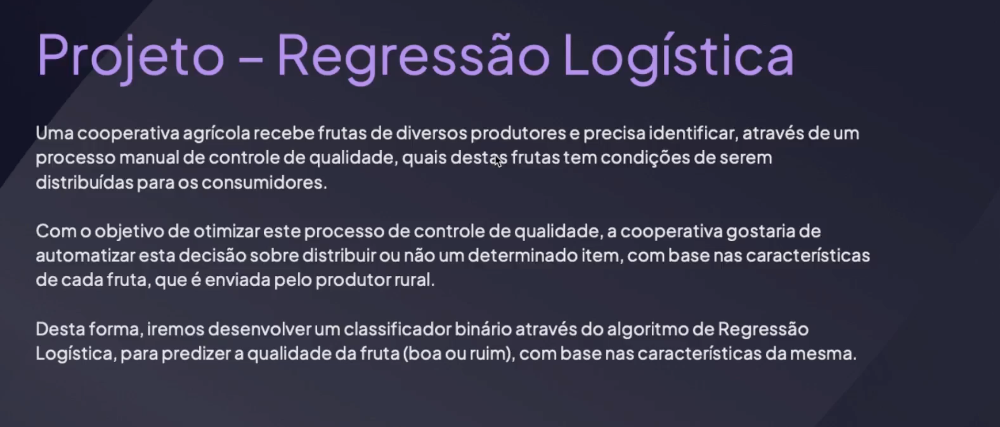

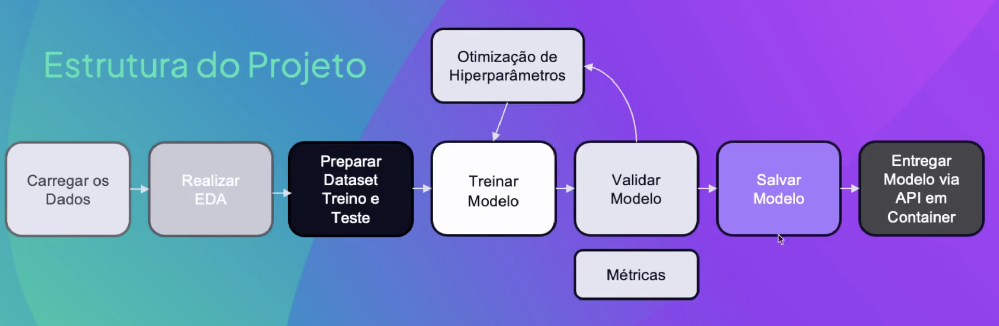

## Importações

`pipenv install pandas pyarrow scikit-learn seaborn plotly nbformat pingouin==0.5.5 optuna fastapi uvicorn pydantic ipywidgets ipykernel -d --skip-lock --python 3.11`

In [1]:
# EDA
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
from pingouin	import ttest

In [41]:
# Machine Learning
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score, roc_curve, auc, log_loss, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split

In [3]:
# Optimização
import optuna

In [5]:
# Carregar dados
df_fruits = pd.read_csv('./dataset/fruit_quality.csv')

## EDA

### Análise do dataframe

In [8]:
# Visualizar registros do dataframe
df_fruits.head(10)

,A_id,Size,Weight,Sweetness,Crunchiness,Juiciness,Ripeness,Acidity,Quality
0,0,-3.970049,-2.512336,5.346330,-1.012009,1.844900,0.329840,-0.491590,good
1,1,-1.195217,-2.839257,3.664059,1.588232,0.853286,0.867530,-0.722809,good
2,2,-0.292024,-1.351282,-1.738429,-0.342616,2.838636,-0.038033,2.621636,bad
3,3,-0.657196,-2.271627,1.324874,-0.097875,3.637970,-3.413761,0.790723,good
4,4,1.364217,-1.296612,-0.384658,-0.553006,3.030874,-1.303849,0.501984,good
5,5,-3.425400,-1.409082,-1.913511,-0.555775,-3.853071,1.914616,-2.981523,bad
6,6,1.331606,1.635956,0.875974,-1.677798,3.106344,-1.847417,2.414171,good
7,7,-1.995462,-0.428958,1.530644,-0.742972,0.158834,0.974438,-1.470125,good
8,8,-3.867632,-3.734514,0.986429,-1.207655,2.292873,4.080921,-4.871905,bad
9,9,-0.727983,-0.442820,-4.092223,0.597513,0.393714,1.620857,2.185608,bad


In [9]:
# Analisar estruturas dos dados
df_fruits.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4000 entries, 0 to 3999
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   A_id         4000 non-null   int64  
 1   Size         4000 non-null   float64
 2   Weight       4000 non-null   float64
 3   Sweetness    4000 non-null   float64
 4   Crunchiness  4000 non-null   float64
 5   Juiciness    4000 non-null   float64
 6   Ripeness     4000 non-null   float64
 7   Acidity      4000 non-null   float64
 8   Quality      4000 non-null   object 
dtypes: float64(7), int64(1), object(1)
memory usage: 281.4+ KB


### Análise da variável Target

In [10]:
# Distribuição da variável Target (Quality) 
px.bar(df_fruits['Quality'].value_counts() / len(df_fruits) * 100)

O modelo está bem distribuído e balanceado

In [ ]:
# Transformar variável Target de string para numérica
df_fruits['Quality'] = df_fruits['Quality'].map({'good': 1, 'bad': 0})

In [ ]:
# Remover coluna de ID (não é necessária para o modelo)
df_fruits.drop(columns=['A_id'], axis=1, inplace=True)

In [14]:
df_fruits.head()

,Size,Weight,Sweetness,Crunchiness,Juiciness,Ripeness,Acidity,Quality
0,-3.970049,-2.512336,5.346330,-1.012009,1.844900,0.329840,-0.491590,1
1,-1.195217,-2.839257,3.664059,1.588232,0.853286,0.867530,-0.722809,1
2,-0.292024,-1.351282,-1.738429,-0.342616,2.838636,-0.038033,2.621636,0
3,-0.657196,-2.271627,1.324874,-0.097875,3.637970,-3.413761,0.790723,1
4,1.364217,-1.296612,-0.384658,-0.553006,3.030874,-1.303849,0.501984,1


### Análise das variáveis independentes

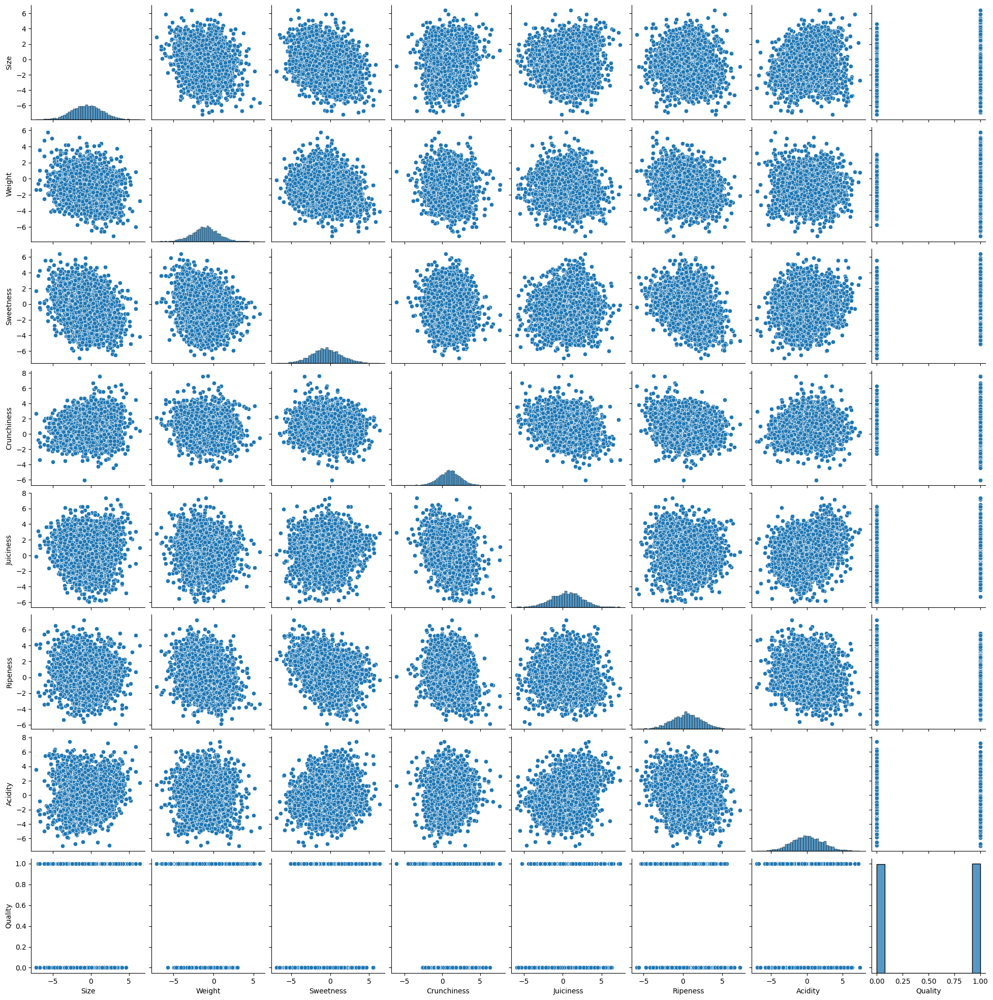

In [16]:
# Verificar a distribuição das variáveis numéricas
sns.pairplot(data=df_fruits, diag_kind='hist')

Aparentemente pelo gráfico não temos uma relação forte entre as variáveis

In [18]:
# Boxplot de Quality por variável - Weight
px.box(df_fruits, x='Quality', y='Weight', color='Quality')

Os valores do peso de frutas Boas e Ruins estão muito próximas, não sendo possível identificar uma correlação

In [19]:
# Boxplot de Quality por variável - Sweetness
px.box(df_fruits, x='Quality', y='Sweetness', color='Quality')

In [20]:
# Boxplot de Quality por variável - Size
px.box(df_fruits, x='Quality', y='Size', color='Quality')

In [21]:
# Teste de T-Student para verificar se as médias das variáveis numéricas são estatisticamente diferentes entre as classes de Quality
# Um teste estatisticos para verificar se existe uma diferença significativa entre as médias dos grupos
# H0 - Não existe diferença significativa entre as médias dos grupos
# H1 - Existe diferença significativa entre as médias dos grupos
good_group_weight = df_fruits[df_fruits['Quality'] == 1]['Weight']
bad_group_weight = df_fruits[df_fruits['Quality'] == 0]['Weight']

ttest(x=good_group_weight, y=bad_group_weight, paired=False)

,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power
T-test,0.089906,3599.742464,two-sided,0.928367,"[-0.09, 0.1]",0.002841,0.036,0.050925


Não há diferença significativa de pesos entre frutas boas e ruins

In [22]:
# Teste de T-Student para verificar se as médias das variáveis numéricas são estatisticamente diferentes entre as classes de Quality
# Um teste estatisticos para verificar se existe uma diferença significativa entre as médias dos grupos
# H0 - Não existe diferença significativa entre as médias dos grupos
# H1 - Existe diferença significativa entre as médias dos grupos
good_group_sweetness = df_fruits[df_fruits['Quality'] == 1]['Sweetness']
bad_group_sweetness = df_fruits[df_fruits['Quality'] == 0]['Sweetness']

ttest(x=good_group_sweetness, y=bad_group_sweetness, paired=False)

,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power
T-test,16.396437,3995.125489,two-sided,1.590329e-58,"[0.86, 1.09]",0.51847,7.576e+54,1.0


Há uma diferença significativa de doçura entre frutas boas e ruins

In [23]:
# Teste de T-Student para verificar se as médias das variáveis numéricas são estatisticamente diferentes entre as classes de Quality
# Um teste estatisticos para verificar se existe uma diferença significativa entre as médias dos grupos
# H0 - Não existe diferença significativa entre as médias dos grupos
# H1 - Existe diferença significativa entre as médias dos grupos
good_group_size = df_fruits[df_fruits['Quality'] == 1]['Size']
bad_group_size = df_fruits[df_fruits['Quality'] == 0]['Size']

ttest(x=good_group_size, y=bad_group_size, paired=False)

,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power
T-test,15.912978,3951.450727,two-sided,2.602204e-55,"[0.82, 1.06]",0.5031,5.053e+51,1.0


Há uma diferença significativa de tamanho entre frutas boas e ruins

### Correlação das variáveis

In [27]:
# Matriz de correlação - Plot Heatmap
corr_matrix = df_fruits.corr()
corr_matrix

,Size,Weight,Sweetness,Crunchiness,Juiciness,Ripeness,Acidity,Quality
Size,1.000000,-0.170702,-0.324680,0.169868,-0.018892,-0.134773,0.196218,0.244007
Weight,-0.170702,1.000000,-0.154246,-0.095882,-0.092263,-0.243824,0.016414,0.001421
Sweetness,-0.324680,-0.154246,1.000000,-0.037552,0.095882,-0.273800,0.085999,0.250998
Crunchiness,0.169868,-0.095882,-0.037552,1.000000,-0.259607,-0.201982,0.069943,-0.012376
Juiciness,-0.018892,-0.092263,0.095882,-0.259607,1.000000,-0.097144,0.248714,0.260223
Ripeness,-0.134773,-0.243824,-0.273800,-0.201982,-0.097144,1.000000,-0.202669,-0.264315
Acidity,0.196218,0.016414,0.085999,0.069943,0.248714,-0.202669,1.000000,-0.007697
Quality,0.244007,0.001421,0.250998,-0.012376,0.260223,-0.264315,-0.007697,1.000000


In [29]:
# Plot Heatmap com Plotly
fig = go.Figure()
fig.add_trace(
  go.Heatmap(
  	x=corr_matrix.columns,
  	y=corr_matrix.index,
  	z=np.array(corr_matrix),
  	text=corr_matrix.values,
  	texttemplate='%{text:.2f}',
  	colorscale=px.colors.diverging.RdBu,
    zmin=-1,
    zmax=1
	)
)
fig.show()

## Treinamento do modelo - Baseline

### Treinamento do modelo

In [30]:
# Definir X e y (variáveis independentes e variável dependente)
X = df_fruits.drop(columns=['Quality'], axis=1)
y = df_fruits['Quality']

In [31]:
# Separar modelo em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=51)

In [32]:
# Criar o objeto do algoritmo Logistic Regression
# Por padrão, o solver é 'lbfgs', mas pode ser alterado para 'liblinear' ou 'sag'
# lbfgs é recomendado para conjuntos de dados de tamanho médio
# liblinear é recomendado para conjuntos de dados pequenos
# sag é recomendado para conjuntos de dados grandes
model_logr = LogisticRegression(solver='liblinear')

In [33]:
# Treinar o modelo de Regressão Logística
model_logr.fit(X_train, y_train)

LogisticRegression(solver='liblinear')

### Predições do modelo

In [35]:
# Fazer previsões com o modelo treinado usando o conjunto de teste
y_pred = model_logr.predict(X_test)
y_pred

array([0, 1, 1, ..., 1, 1, 0])

In [38]:
# Decision Function
# retorna o valor calculado (score) de cada instância, considerando os coeficientes obitdos da reta de regressão
y_decision = model_logr.decision_function(X_test)
y_decision

array([-0.62262518,  0.03737776,  0.24573024, ...,  0.2610187 ,
        0.4326487 , -2.21871192])

In [ ]:
# Retornar as probabilidades de cada classe (0 e 1) para cada instância no conjunto de teste
# O objeto retornado é uma matriz com duas colunas
# A primeira coluna é a probabilidade da classe 0 e a segunda coluna é a probabilidade da classe 1
y_prob = model_logr.predict_proba(X_test)
y_prob

array([[0.65081537, 0.34918463],
       [0.49065665, 0.50934335],
       [0.43887471, 0.56112529],
       ...,
       [0.43511331, 0.56488669],
       [0.39349402, 0.60650598],
       [0.90191731, 0.09808269]])

### Métricas do Baseline

In [ ]:
# Retornar valores da curva ROC - TPR (True Positive Rate) e FPR (False Positive Rate), Tresholds
# A curva ROC é uma representação gráfica da taxa de verdadeiros positivos (TPR) em função da taxa de falsos positivos (FPR) para diferentes valores de threshold
fpr, tpr, thresholds = roc_curve(y_test, y_decision)

In [42]:
# Calcular a métrica AUC (Area Under the Curve) da curva ROC
# AUC é uma métrica que representa a probabilidade de que um classificador atribua uma pontuação mais alta a uma instância positiva do que a uma negativa
roc_auc = auc(fpr, tpr)
roc_auc

np.float64(0.8414568425263345)

Como o valor de roc_auc foi alta (próxima de 1), o classificador pode ser considerado um bom classificador

In [ ]:
# Plotar a curva ROC
fig = px.area(
  x=fpr,
  y=tpr,
  title=f'Curva ROC (AUC = {roc_auc:.4f})',
  labels=dict(x='Taxa de Falsos Positivos (FPR)', y='Taxa de Verdadeiros Positivos (TPR)'),
  width=700,
  height=500,
)

fig.add_shape(
  type='line',
  x0=0,
  x1=1,
  y0=0,
  y1=1,
)

fig.update_yaxes(scaleanchor="x", scaleratio=1)
fig.update_xaxes(constrain='domain')

fig.show()

In [50]:
# Apresentar a importância das features (com base no coeficiente obtidos na regressão logística)
# Quanto maior o valor absoluto do coeficiente, maior a importância da feature
importance = np.abs(model_logr.coef_)
print("Importância das features:")
for idx, feature in enumerate(model_logr.feature_names_in_):
		print(f"{feature}: {importance[0][idx]:.4f}")


Importância das features:
Size: 0.6050
Weight: 0.2502
Sweetness: 0.5489
Crunchiness: 0.0236
Juiciness: 0.4355
Ripeness: 0.1246
Acidity: 0.2773


In [51]:
# F1-Score - Métrica de Avaliação
# É uma média harmonica entre a Precisão e o Recall
# Precisão é a proporção de verdadeiros positivos em relação ao total de positivos previstos
# Recall é a proporção de verdadeiros positivos em relação ao total de positivos reais
f1_score_baseline = f1_score(y_test, y_pred)
f1_score_baseline

np.float64(0.7787903893951947)

In [62]:
# Apresentar o BCE (Binary Cross-Entropy) - Log Loss
# BCE é uma métrica que mede a diferença entre a distribuição real e a distribuição prevista
# Quanto menor o valor de BCE, melhor o modelo
bce_baseline = log_loss(y_test, y_pred)
bce_baseline

8.019712879078565

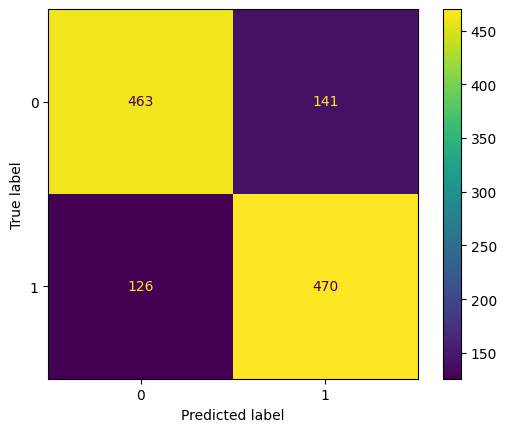

In [53]:
# Mostrar matriz de confusão
confusion_matrix_baseline = confusion_matrix(y_test, y_pred)
disp_baseline = ConfusionMatrixDisplay(confusion_matrix_baseline)
disp_baseline.plot()

## Treinamento do modelo - Otimizado

### Otimização dos hiperparâmetros

Hiperparâmetro penalty
Define a norma usada na penalização

'l1' - Regularização L1 (Lasso)
É usada para seleção de features e modelos esparsos. Atua na soma dos valores absolutos dos coeficientes

'l2' - Regularização L2 (Ridge)
É usada para reduzir a variância do modelo, principalmente quando há multicolinearidade. Atua na soma dos quadrados dos coeficientes

'none' - Sem regularização
Não aplica nenhuma penalização aos coeficientes

Regularização é uma técnica para controlar a complexidade do modelo, reduzir o overfitting e melhorar a generalização

Hiperparâmetro C
Define o inverso da força de regular
Quanto menor o valor de C, maior a força de regularização
Quanto maior o valor de C, menor a força de regularização
Valores típicos para C são 0.001, 0.01, 0.1, 1, 10, 100, 1000
C é o inverso do parâmetro de regularização alpha em outras implementações de regressão logística
Quando há um overfitting, é recomendado aumentar o valor de C para reduzir a regularização
Quando há um underfitting, é recomendado diminuir o valor de C para aumentar a regularização

In [54]:
# Otimização dos hiperparâmetros do modelo de Regressão Logística com Optuna
def lr_optuna(trial):
  penalty = trial.suggest_categorical('penalty', ['l1', 'l2'])
  c_values = trial.suggest_categorical('C', [100, 10, 1.0, 0.1, 0.01])

	# Treinar o modelo
  model_lr_optuna = LogisticRegression(penalty=penalty, C=c_values, solver='liblinear')
  model_lr_optuna.fit(X_train, y_train)
  
	# Retornar a decision function
  Y_decision_optuna = model_lr_optuna.decision_function(X_test)
  
	# Calcular a curva ROC
  fpr, tpr, thresholds = roc_curve(y_test, Y_decision_optuna)
  
	# Calcular a métrica AUC
  roc_auc_optuna = auc(fpr, tpr)
  
	# Retornar predição
  y_pred_optuna = model_lr_optuna.predict(X_test)
  
	# Calcular o F1-Score
  f1_score_optuna = f1_score(y_test, y_pred_optuna, average='macro')
  
	# Calcular o BCE
  log_loss_optuna = log_loss(y_test, y_pred_optuna)
	
  return roc_auc, f1_score_optuna, log_loss_optuna

In [57]:
# Criar estudo e executar a otimização com Optuna
search_space = {'penalty': ['l1', 'l2'], 'c': [100, 10, 1.0, 0.1, 0.01]}
sampler = optuna.samplers.GridSampler(search_space)

lr_study = optuna.create_study(directions=['maximize', 'maximize', 'minimize'])
lr_study.optimize(lr_optuna, n_trials=20)

[I 2024-11-03 19:17:47,807] A new study created in memory with name: no-name-41cb0725-347d-4161-8b8c-70f0697bcb8e
[I 2024-11-03 19:17:47,815] Trial 0 finished with values: [0.8414568425263345, 0.7412621911352295, 9.281240747697666] and parameters: {'penalty': 'l1', 'C': 0.01}.
[I 2024-11-03 19:17:47,822] Trial 1 finished with values: [0.8414568425263345, 0.7774924285618052, 8.019712879078565] and parameters: {'penalty': 'l2', 'C': 100}.
[I 2024-11-03 19:17:47,832] Trial 2 finished with values: [0.8414568425263345, 0.7774998454860038, 8.019712879078567] and parameters: {'penalty': 'l2', 'C': 0.1}.
[I 2024-11-03 19:17:47,839] Trial 3 finished with values: [0.8414568425263345, 0.7766610831937465, 8.04974925690283] and parameters: {'penalty': 'l1', 'C': 1.0}.
[I 2024-11-03 19:17:47,844] Trial 4 finished with values: [0.8414568425263345, 0.7774924285618052, 8.019712879078565] and parameters: {'penalty': 'l2', 'C': 1.0}.
[I 2024-11-03 19:17:47,850] Trial 5 finished with values: [0.8414568425

In [58]:
# Mostrar o melhor valor de AUC, F1-Score e BCE obtidos na otimização
best_trial = max(lr_study.best_trials, key=lambda trial: trial.values[1])
print(f"Trail com maior AUC e F1 e menor BCE: ")
print(f'\tnumber: {best_trial.number}')
print(f'\tparams: {best_trial.params}')
print(f'\values: {best_trial.values}')

Trail com maior AUC e F1 e menor BCE: 
	number: 2
	params: {'penalty': 'l2', 'C': 0.1}
alues: [0.8414568425263345, 0.7774998454860038, 8.019712879078567]


In [59]:
# Mostrar gráfico com Trials do estudo
fig = optuna.visualization.plot_pareto_front(lr_study)
fig.show()

### Comparação entre melhor resultado e baseline

In [ ]:
# Compara entre o AUC do baseline e o AUC do melhor trial
print(f'AUC: baseline={roc_auc} optuna={best_trial.values[0]}')


AUC: baseline=0.8414568425263345 optuna=0.8414568425263345


In [61]:
# Compara entre o F1-Score do baseline e o AUC do melhor trial
print(f'F1-Score: baseline={f1_score_baseline} optuna={best_trial.values[1]}')

F1-Score: baseline=0.7787903893951947 optuna=0.7774998454860038


In [63]:
# Compara entre o BCE do baseline e o AUC do melhor trial
print(f'BCE: baseline={bce_baseline} optuna={best_trial.values[2]}')

BCE: baseline=8.019712879078565 optuna=8.019712879078567


### Alterar threshold do modelo

In [68]:
# Fazer um loop e eapresentar o F! Score para cada threshold
threshold_list = np.arange(0.55, 0.95, 0.05)
result_list = { 'scenarios': [], 'result': []}
result_list['scenarios'].append('baseline')
result_list['result'].append(f1_score_baseline)
result_list['scenarios'].append('optuna')
result_list['result'].append(best_trial.values[1])

for new_threshold in threshold_list:
	y_pred_threshold = (model_logr.predict_proba(X_test)[:, 1] >= new_threshold).astype(int)
	f1_score_threshold = f1_score(y_test, y_pred_threshold, average='macro')
	result_list['scenarios'].append(str(new_threshold))
	result_list['result'].append(f1_score_threshold)

In [69]:
# Criar dataframe com resultados
df_result_thresholds = pd.DataFrame(result_list)
df_result_thresholds

,scenarios,result
0,baseline,0.778790
1,optuna,0.777500
2,0.55,0.758622
3,0.6000000000000001,0.749562
4,0.6500000000000001,0.720718
5,0.7000000000000002,0.688131
6,0.7500000000000002,0.656890
7,0.8000000000000003,0.614942
8,0.8500000000000003,0.548762
9,0.9000000000000004,0.443542


In [71]:
# Plotar o F1-Score para cada threshold
fig = px.line(df_result_thresholds, x='scenarios', y='result', title='F1-Score para cada threshold')
fig.show()

## Salvar o modelo

In [72]:
import joblib
joblib.dump(model_logr, './model_fruit_quality.pkl')

['./model_fruit_quality.pkl']